In [ ]:
import subprocess

cmd = [
    'python', 'train.py',
    '--img', '1280',
    '--batch', '16',
    '--epochs', '100',
    '--data', 'car.yaml',
    '--cfg', 'models/yolov5n.yaml',
    '--weights', 'yolov5n.pt',
    '--name', 'yolov5n_default'
]

with subprocess.Popen(cmd, stdout=subprocess.PIPE, stderr=subprocess.STDOUT, bufsize=1, universal_newlines=True) as p:
    for line in p.stdout:
        print(line, end='')


train: weights=yolov5n.pt, cfg=models/yolov5n.yaml, data=car.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=1280, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data\hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs\train, name=yolov5n_default, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github: skipping check (not a git repository), for updates see https://github.com/ultralytics/yolov5
YOLOv5  2025-7-9 Python-3.11.13 torch-2.5.1 CUDA:0 (NVIDIA GeForce RTX 4070 Ti SUPER, 16375MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, wa

In [2]:
import subprocess

cmd = [
    'python', 'val.py',
    '--data', 'car.yaml',  # test set 경로는 car.yaml 내 test: ... 로 지정되어 있어야 함
    '--weights', 'runs/train/yolov5n_default/weights/best.pt',
    '--task', 'test',
    '--img', '1280'
]

with subprocess.Popen(cmd, stdout=subprocess.PIPE, stderr=subprocess.STDOUT, bufsize=1, universal_newlines=True) as p:
    for line in p.stdout:
        print(line, end='')

val: data=C:\Users\MOON\Desktop\Project\ECM-Video\yolov5\data\car.yaml, weights=['runs/train/yolov5n_default/weights/best.pt'], batch_size=32, imgsz=1280, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs\val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5  2025-7-9 Python-3.11.13 torch-2.5.1 CUDA:0 (NVIDIA GeForce RTX 4070 Ti SUPER, 16375MiB)

Fusing layers... 
YOLOv5n summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs

test: Scanning C:\Users\MOON\Desktop\Project\ECM-Video\yolov5\dataset\labels\test...:   0%|          | 0/2308 [00:00<?, ?it/s]
test: Scanning C:\Users\MOON\Desktop\Project\ECM-Video\yolov5\dataset\labels\test... 1 images, 0 backgrounds, 0 corrupt:   0%|          | 1/2308 [00:06<4:21:47,  6.81s/it]
test: Scanning C:\Users\MOON\Desktop\Project\ECM-Video\yolov5\dataset\labels\test... 17 images, 0

In [4]:
import torch
from pathlib import Path
from PIL import Image

# 모델 로드
model = torch.hub.load('ultralytics/yolov5', 'custom', path='runs/train/yolov5n_default/weights/best.pt')

# 테스트 이미지 폴더
test_dir = Path('.dataset/images/test')

# 평가 결과 저장
save_dir = Path('runs/test_output')
save_dir.mkdir(parents=True, exist_ok=True)

# 이미지 순회
for img_path in test_dir.glob('*.jpg'):
    results = model(str(img_path))
    results.save(save_dir)  # 자동으로 annotated 이미지 저장
    print(f'Processed {img_path.name}')

Using cache found in C:\Users\MOON/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-7-10 Python-3.11.13 torch-2.5.1 CUDA:0 (NVIDIA GeForce RTX 4070 Ti SUPER, 16375MiB)

Fusing layers... 
YOLOv5n summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs
Adding AutoShape... 


Using cache found in C:\Users\MOON/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-7-10 Python-3.11.13 torch-2.5.1 CUDA:0 (NVIDIA GeForce RTX 4070 Ti SUPER, 16375MiB)

Fusing layers... 
YOLOv5n summary: 157 layers, 1760518 parameters, 0 gradients, 4.1 GFLOPs
Adding AutoShape... 
C:\Users\MOON/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
image 1/1: 1920x1080 2 Cars
Speed: 20.8ms pre-process, 6.3ms inference, 10.1ms NMS per image at shape (1, 3, 640, 384)


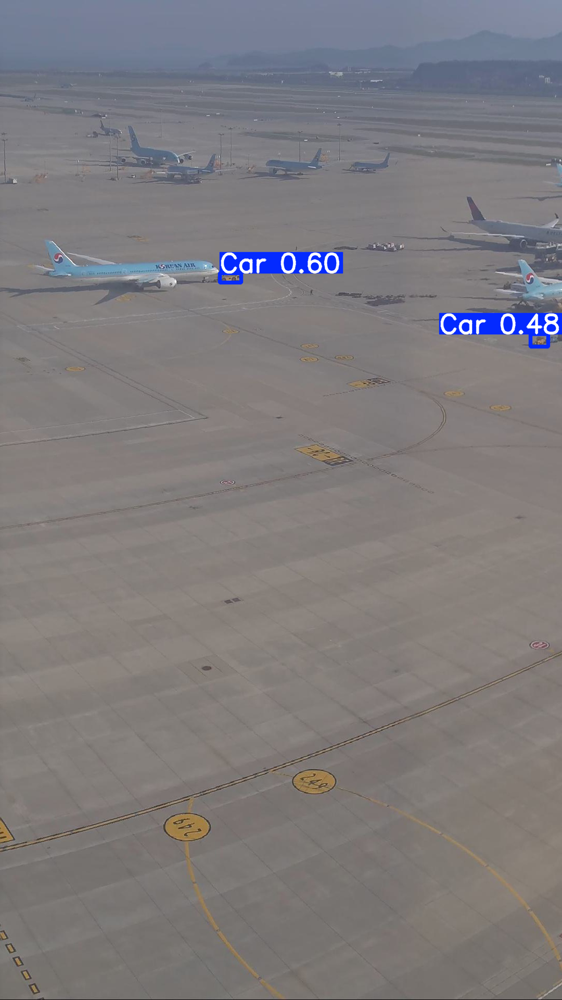

Saved 1 image to runs\detect\exp2


          xmin        ymin         xmax        ymax  confidence  class name
0   422.637695  524.148499   463.449402  542.630920    0.595258      0  Car
1  1019.085754  641.142212  1053.651855  665.176697    0.484230      0  Car


In [8]:
import torch

# 모델 로드 (학습된 모델 사용)
model = torch.hub.load('ultralytics/yolov5', 'custom', path='runs/train/yolov5n_default/weights/best.pt')

# 이미지 경로
img_path = r'C:\Users\MOON\Desktop\Project\ECM-Video\yolov5\dataset\images\test\pano_south_2024-05-04_08-01-39.500_tile_0006.jpg'

# 예측 수행
results = model(img_path)

# 예측된 결과 보기
results.print()          # 콘솔에 class, confidence, bbox 출력
results.show()           # 이미지 위에 bbox 표시 (Jupyter 환경)
results.save()           # runs/detect/exp/ 아래 이미지 저장됨

# 결과를 pandas로 확인 (원하는 경우)
df = results.pandas().xyxy[0]  # 결과를 DataFrame으로 받음
print(df)